In [ ]:
def plotGraph(x = [], y = [], xArray = [], yArray = [], yLegend = [], title = "", 
              xlabel = "", ylabel = "", caption = "", saveTo = "", show = True, xlim = [], ylim = [], figX = 16, figY = 16):

***
# Read in all the files into a dictionairy <font color=grey>(Need)</font>
***

In [1]:
%run HelperFunctions.ipynb
import p398dlp_read_audio_function as RA  #audio file reader
import numpy as np
import matplotlib.pyplot as plt

max_buffers = 10**7
files = {}
import os

# Type the path to the folder with the files you want to read in the program. Then run this cell (ctrl-Enter).
######################################################
pathName = "./RawData/Sound"
######################################################

directory = os.fsencode(pathName)

for file in os.listdir(directory):
    filename = os.fsdecode(file)
    if filename.endswith(".bin"):
        print("/////////////////////////////////////////")
        files[filename] = RA.read_audio(pathName + "/" + filename, max_buffers)
        files[filename] = files[filename] - np.mean(files[filename])
        print("///////////////////////////////////////// \n")
    else:
        continue

/////////////////////////////////////////
reading from file  ./RawData/Sound/audio00A-0.bin
ADC clock frequency (kHz)  1000.0
CPU clock frequency (kHz)  16000.0
ADC sample interval in CPU cycles  496
Arduino ADC analog pin recorded  7
Hit end of file, so exit the ADC data reading loop

All done. ADC data buffers read:  12190
ADC digitizations read:  3096004
this corresponds to  1.6125020833333332  minutes of recording
///////////////////////////////////////// 

/////////////////////////////////////////
reading from file  ./RawData/Sound/audio00B-0.bin
ADC clock frequency (kHz)  1000.0
CPU clock frequency (kHz)  16000.0
ADC sample interval in CPU cycles  496
Arduino ADC analog pin recorded  7
Hit end of file, so exit the ADC data reading loop

All done. ADC data buffers read:  13570
ADC digitizations read:  3446524
this corresponds to  1.7950645833333332  minutes of recording
///////////////////////////////////////// 

/////////////////////////////////////////
reading from file  ./RawDa

///////////////////////////////////////// 

/////////////////////////////////////////
reading from file  ./RawData/Sound/audio06B-850.bin
ADC clock frequency (kHz)  1000.0
CPU clock frequency (kHz)  16000.0
ADC sample interval in CPU cycles  496
Arduino ADC analog pin recorded  7
Hit end of file, so exit the ADC data reading loop

All done. ADC data buffers read:  76146
ADC digitizations read:  19340828
this corresponds to  10.073347916666668  minutes of recording
///////////////////////////////////////// 

/////////////////////////////////////////
reading from file  ./RawData/Sound/audio06C-900.bin
ADC clock frequency (kHz)  1000.0
CPU clock frequency (kHz)  16000.0
ADC sample interval in CPU cycles  496
Arduino ADC analog pin recorded  7
Hit end of file, so exit the ADC data reading loop

All done. ADC data buffers read:  54320
ADC digitizations read:  13797024
this corresponds to  7.18595  minutes of recording
///////////////////////////////////////// 

/////////////////////////////

***
# Saving All the Raw Sound Graphs  <font color=grey>(Don't Need)</font>
***

audio00A-0.bin | size: 3096004 | time: 96.750125 sec


C:\Users\shoha\AppData\Roaming\Python\Python37\site-packages\ipykernel_launcher.py:18: DeprecationWarning: object of type <class 'float'> cannot be safely interpreted as an integer.


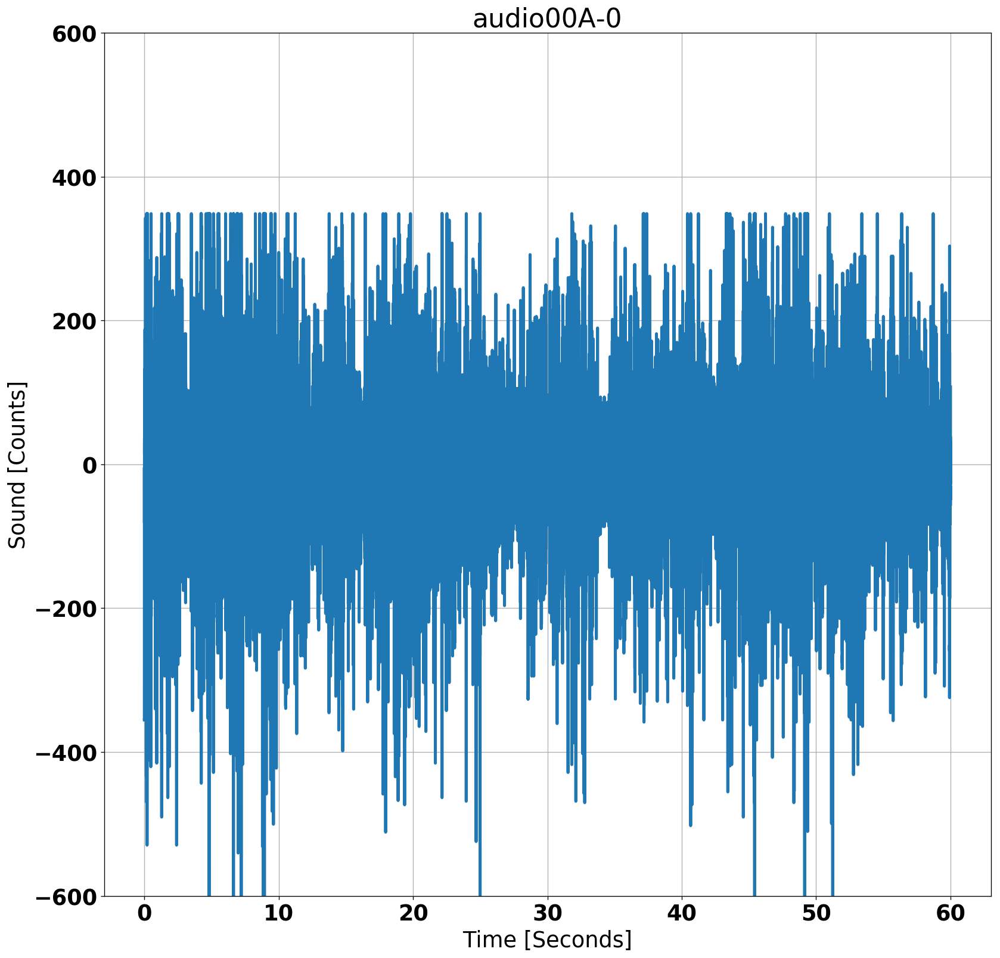

In [8]:
#########################
# This is if you want the Count vs. Sound graphs (you don't have to run this cell)
#########################

%run HelperFunctions.ipynb
samplingRate = 32000 #samples / sec

# The path of where you want the file saved
############################################
filePath = "FinalData/RawSoundGraphs/"
############################################

for file in files:
    fileSize = len(files[file])
    recTime = fileSize / samplingRate
    print(file, "| size:" ,fileSize, "| time:", recTime, "sec")
    xs = files[file]
    ts = np.linspace(0, recTime, recTime*samplingRate)
    if (fileSize > 2000000): # Making sure not to try to graph more than 2million points
        xs = files[file][0:samplingRate*60]
        ts = np.linspace(0, 60, samplingRate*60)    
        fileToSave = filePath + file[:4] + "Graph.png"

    plotGraph(x = ts,y = xs, title = file[:-4] + "", xlabel = "Time [Seconds]",
              ylabel = "Sound [Counts]", #saveTo = fileToSave,
              show = True, ylim = [-600,600])
    break

5333 32000


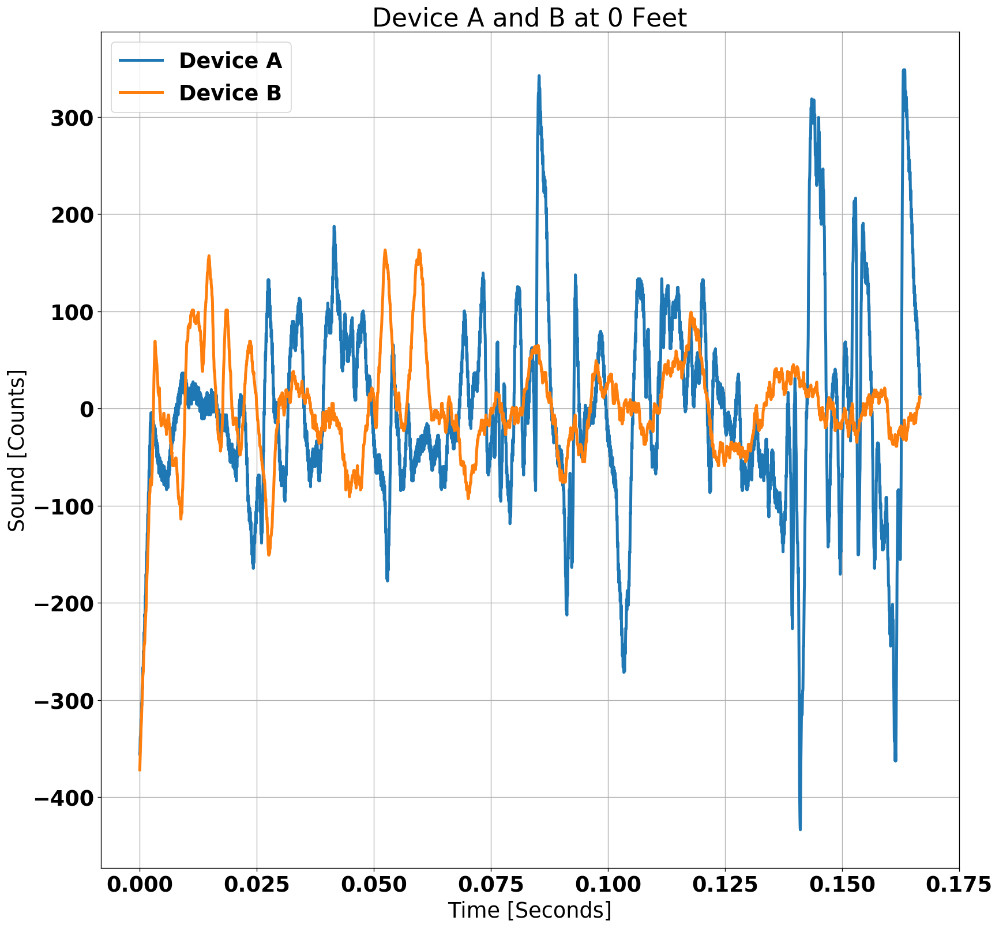

In [64]:
#################################################
timeFrom = 0
timeTo = 10/60
offset = 0
################################################

indFrom = int(timeFrom*samplingRate)
indTo = int(timeTo*samplingRate)
indOffset = offset*samplingRate
x = np.linspace(timeFrom,timeTo, indTo-indFrom)
ys = [files['audio00A-0.bin'][indFrom:indTo], files['audio00B-0.bin'][int(indFrom+indOffset):int(indTo+indOffset)]]
print(len(x),len(y1))
legend = ["Device A", "Device B"]
plotGraph(x, yArray=ys, xlabel = "Time [Seconds]",
              ylabel = "Sound [Counts]", yLegend=legend, title="Device A and B at 0 Feet")

***
# Creating a dictionairy of the fourier transformed recordings <font color=green>(Need)</font>
***

In [3]:
##########
# Run this code if you want to use the cells below !!!!
#########

import time
import numpy as np

FFTfiles = {}

samplingRate = 32000
for file in files:
    myList = files[file]
    numOfPoints = len(myList)
    samples = 5*5*5*5*7*7*7*7*2*2*2
    if (samples > numOfPoints):
        samples = 216090*13
    start = time.time();
    FFT = np.fft.fft(myList[:samples])
    FFTAbs = np.abs(FFT)
    freqs = np.fft.fftfreq(len(FFT), 1/samplingRate)
    runTime = time.time() - start
    print(file + " | " + "# Points in file: ", numOfPoints, " | " + "# Samples taken: ", samples,
          "| FFT run time:", runTime)
    FFTfiles[file] = [freqs, FFTAbs]

audio00A-0.bin | # Points in file:  3096004  | # Samples taken:  2809170 | FFT run time: 0.8227975368499756
audio00B-0.bin | # Points in file:  3446524  | # Samples taken:  2809170 | FFT run time: 0.882638692855835
audio01A-50.bin | # Points in file:  10208766  | # Samples taken:  2809170 | FFT run time: 0.6751937866210938
audio01B-100.bin | # Points in file:  13063340  | # Samples taken:  12005000 | FFT run time: 4.1339380741119385
audio01C-150.bin | # Points in file:  12011912  | # Samples taken:  12005000 | FFT run time: 3.573438882827759
audio02A-200.bin | # Points in file:  12625322  | # Samples taken:  12005000 | FFT run time: 3.4757046699523926
audio02B-250.bin | # Points in file:  12379704  | # Samples taken:  12005000 | FFT run time: 3.6073501110076904
audio02C-300.bin | # Points in file:  20755100  | # Samples taken:  12005000 | FFT run time: 3.4228439331054688
audio03A-350.bin | # Points in file:  12153390  | # Samples taken:  12005000 | FFT run time: 3.5604746341705322
audi

***
# Saving Graphs of Raw Frequencies [Not Averaged] <font color=grey>(Don't Need)</font>
***

KeyboardInterrupt: 

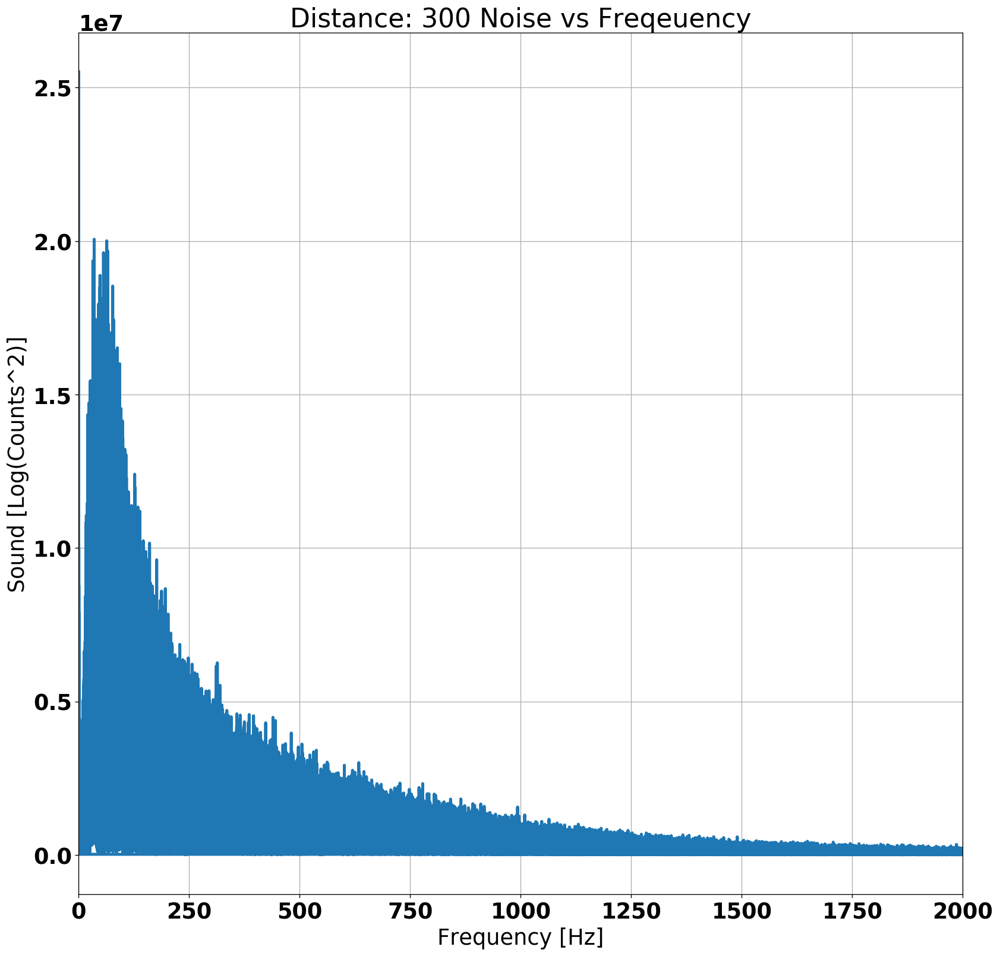

In [4]:
#########################
# This is if you want the Count vs. Freq graphs (you don't have to run this cell)
#########################

%run HelperFunctions.ipynb

# Path to folder you want to save the graph to
######################
filePath = "FFTGraphs/0-2000Hz/"
######################

for file in FFTfiles:
    title = "Distance: " + file[8:-4] + " Noise vs Freqeuency"
    saveFile = filePath + file[:-4] + "(Raw) Frequency Graph.png"
    plotGraph(x = FFTfiles[file][0],y = FFTfiles[file][1], xlim = [0,2000], saveTo = saveFile,
             title = title, xlabel = "Frequency [Hz]",
              ylabel = "Sound [Log(Counts^2)]", show = False) # Change show to True if you want to see the graphs

***
# Averaging over select Hz bins <font color=green>(Need)</font>
***

In [ ]:
import time

averagedData = {}

# Steps to average over
###########################
FreqSteps = 1.0 # Hz
###########################

for file in FFTfiles:
    AveFreq = []
    AveFFT = []
    aveFreq = 0
    numOfPoints = 1
    currSum = 0
    startTime = time.time()
    for i in range(0,len(FFTfiles[file][0])): #go over all the freqs
        currFreq = FFTfiles[file][0][i]
        if (currFreq > aveFreq and currFreq < aveFreq + FreqSteps):
            AveFFT.append(np.log(currSum/numOfPoints))
            AveFreq.append(currFreq)
            numOfPoints = 1
            currSum = 0
            aveFreq += FreqSteps
        currSum += FFTfiles[file][1][i]
        numOfPoints += 1
    runTime = time.time() - startTime
    averagedData[file] = [AveFreq, AveFFT]  
    print(file, "| Run Time:", runTime)

audio00A-0.bin | Run Time: 3.1063663959503174
audio00B-0.bin | Run Time: 2.726877212524414
audio01A-50.bin | Run Time: 2.7734251022338867


***
# Saving Graphs of Ave Frequencies <font color=grey>(Don't Need)</font>
***

In [4]:
#########################
# This is if you want the Count vs. Averaged Freq graphs (you don't have to run this cell)
#########################

%run HelperFunctions.ipynb

# Path to folder you want the graphs saved in
#######################
filePath = "FinalData/FrequencyGraphs05Hz[50]/"
#######################

for file in averagedData:
    title = "Distance: " + file[8:-4] + " (Averaged to " + str(FreqSteps) + " Hz) Noise vs Freqeuency"
    saveFile = filePath + file[:-4] + " (Averaged to " + str(FreqSteps) + " Hz) Frequency Graph.png"
    plotGraph(x = averagedData[file][0], y = averagedData[file][1], xlim = [0,50], saveTo = saveFile,
             title = title , xlabel = "Frequency [Hz]", ylim = [10,16],
              ylabel = "Sound [ln(Counts)]", show = True)

NameError: name 'averagedData' is not defined

***
# Creating Graph for different locations <font color=grey>(Don't Need)</font>
***

In [1]:
%run HelperFunctions.ipynb
import numpy as np
import statistics as stat
x = []
legend = []
ys = []
# Tunable parameters
# **************************************
freqFrom = 0
freqTo = 500
freqIntervals = 100
device = ['A']
# **************************************
# adding distances
if ('A' in device):
    x.extend([0])
    x.extend(range(50,1400,150))
    x.extend([1600])
if ('B' in device):
    x.extend([0])
    x.extend(range(100,1400,150))
    x.extend([1600])
if ('C' in device):
    x.extend([0])
    x.extend(range(150,1400,150))
    x.extend([1600])
x.sort()
for i in range(freqFrom,freqTo,freqIntervals):
    y = []
    for file in averagedData:
        if (file[7] not in device):
            continue
        data = averagedData[file][1][i:(i + freqIntervals)]
        toSubtract = averagedData[file][1][500:(500 + freqIntervals)]
        if (len(data)==0):
            print("(WARNING) Bad data in file:", file)
            y.append(0)
            continue
        ave = stat.mean(data) - stat.mean(toSubtract)
        y.append(ave)
    legend.append(str(i) + " Hz - " + str(i + freqIntervals) + " Hz")
    ys.append(y)

title = str(freqFrom) + "Hz - " + str(freqTo) + "Hz, " + str(freqIntervals) + "Hz Intervals"
saveTo = "MultipleFreqGraphs/" + title
plotGraph(x = x, yArray = ys, title = title, yLegend = legend, figX = 16, figY = 8, #saveTo = saveTo,
          xlabel = "Distance From Turbine [Feet]", ylabel = "Sound [Log(Counts)]")

NameError: name 'averagedData' is not defined

***
# Creating a Graph of the frequencies overlayed <font color=grey>(Don't Need)</font>
***

0
0
0
0
50
50
100
100
150
150
200
200
250
250
300
300
350
350
400


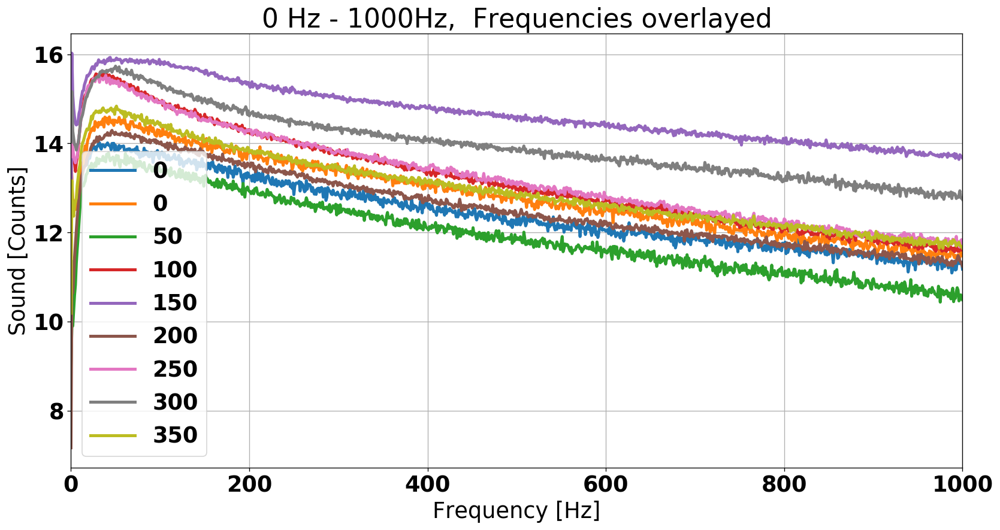

In [26]:
%run HelperFunctions.ipynb
import numpy as np
import statistics as stat

ys = []
lgd = []
# Tunable parameters
##########################################
freqFrom = 0
freqTo = 1000
distanceFrom = 0
distanceTo = 350
devices = ['A','B','C']
onlyDistance = []
#########################################

for file in averagedData:
    print(file[9:-4])
    if (onlyDistance != [] and int(file[9:-4]) not in onlyDistances):
        continue
    if (onlyDistance == [] and int(file[9:-4]) < distanceFrom):
        continue
    if (onlyDistance == [] and int(file[9:-4]) > distanceTo):
        break
    if (file[7] not in devices):
        continue
    if (len(averagedData[file][1]) == 0):
        continue;
    print(file[9:-4])
    x = averagedData[file][0]
    ys.append(averagedData[file][1])
    lgd.append(file[9:-4])

title = "0 Hz - " + str(freqTo) + "Hz, " + " Frequencies overlayed"
saveTo = "OverlayGraphs/" + title
plotGraph(x = x, yArray = ys, title = title, xlim = [freqFrom,freqTo],  yLegend = lgd, figX = 16, figY = 8,
          xlabel = "Frequency [Hz]", ylabel = "Sound [Counts]", saveTo = saveTo)

***
# Spectogram <font color=gray>(Don't Need)</font>
***

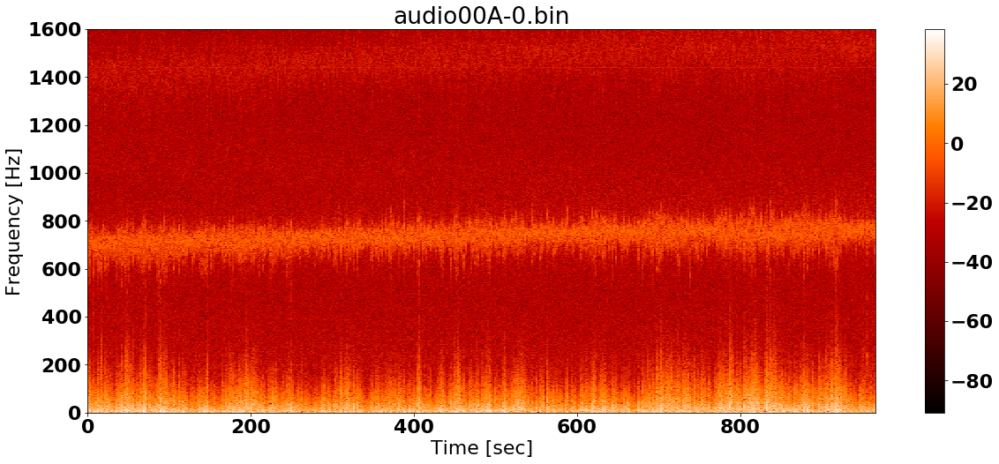

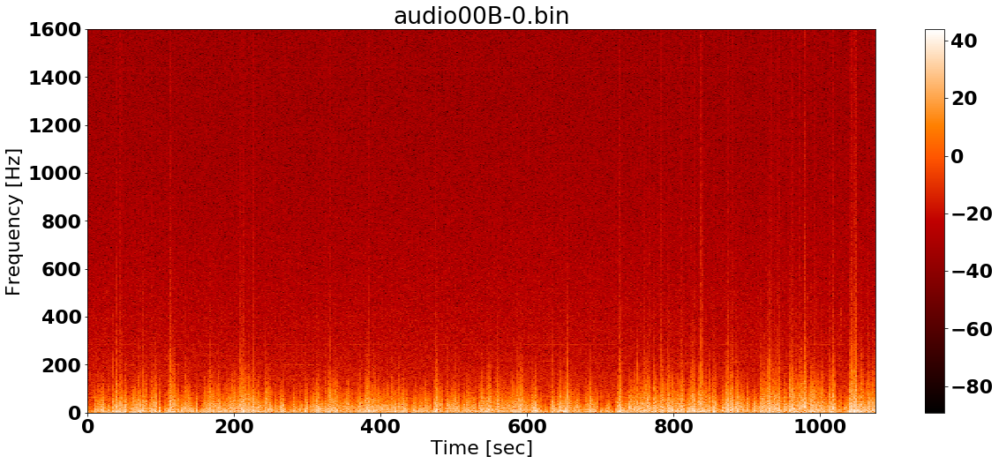

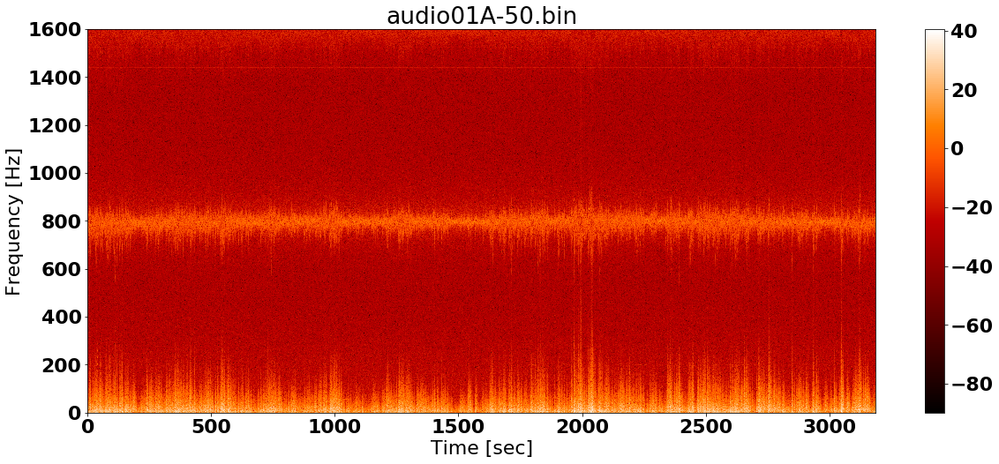

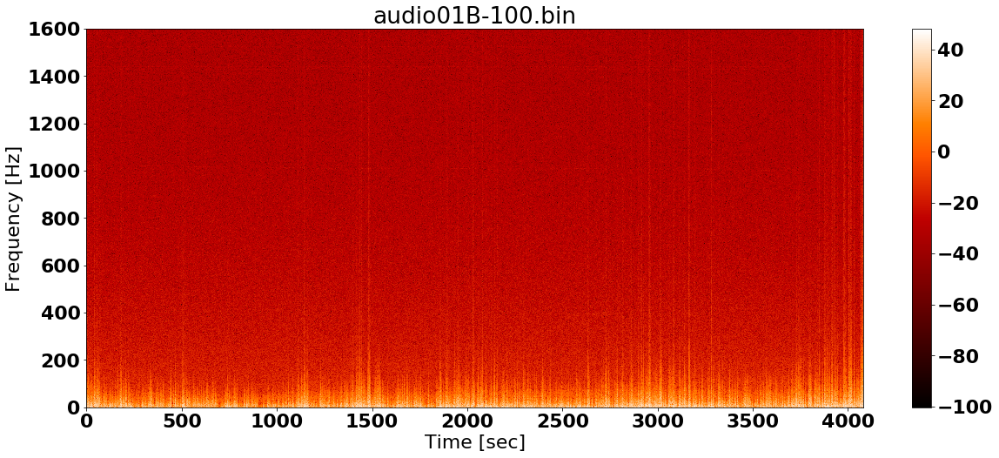

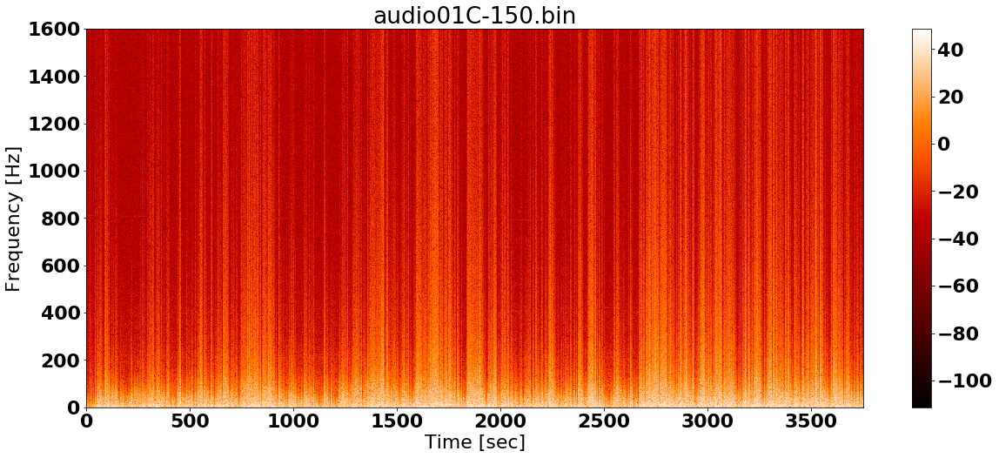

...

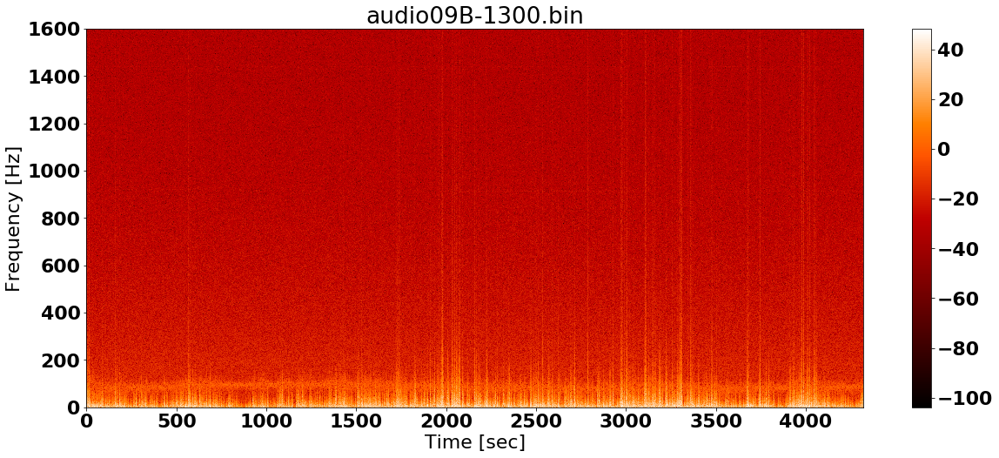

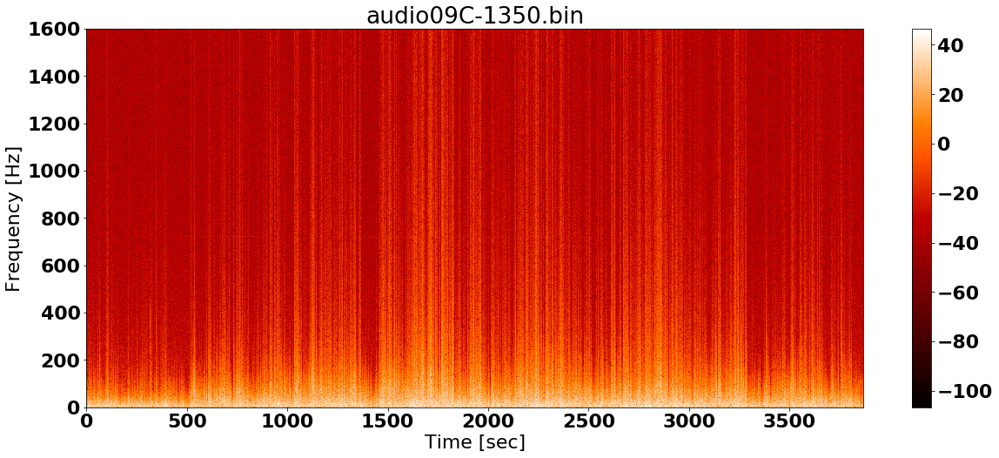

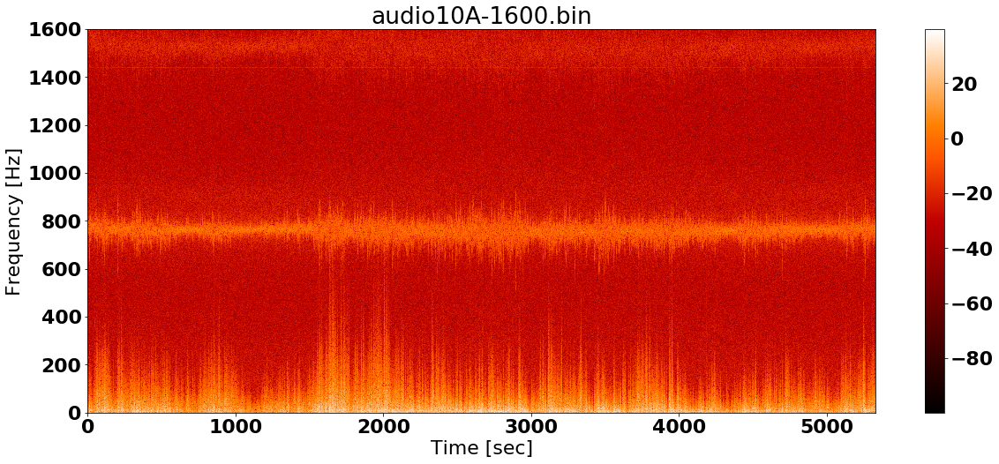

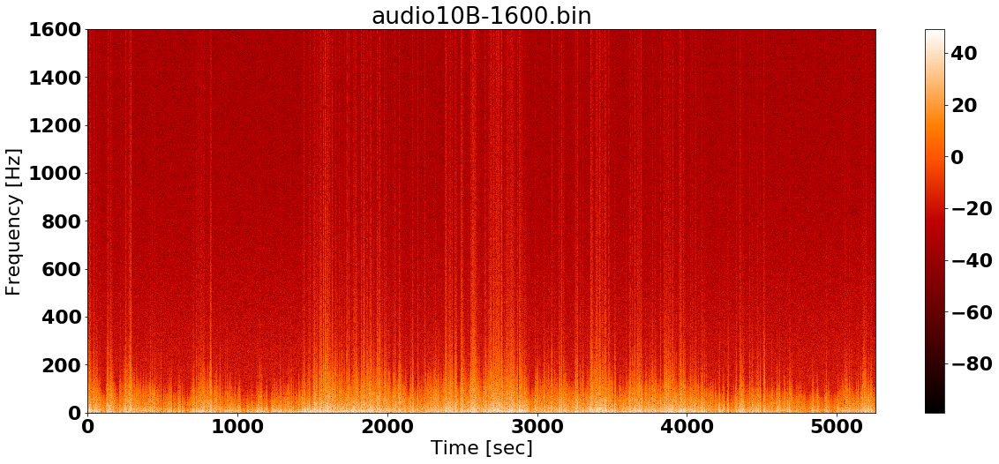

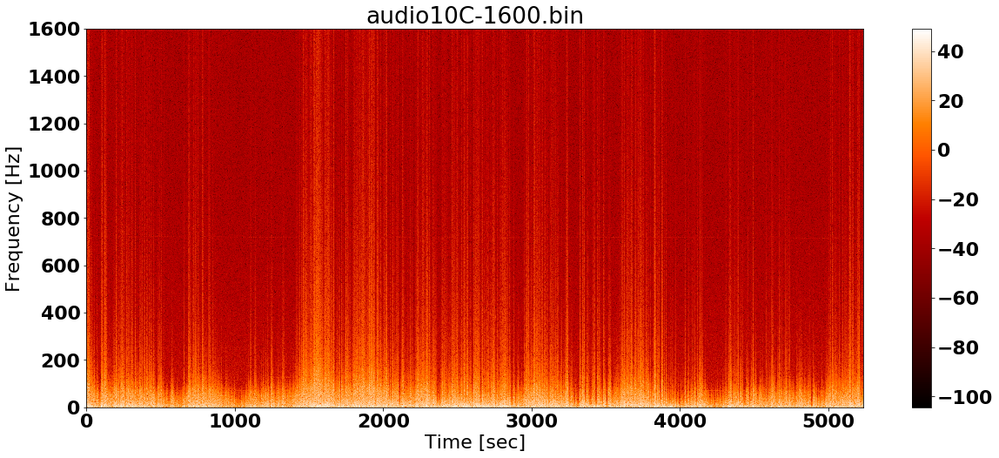

In [27]:
import matplotlib.pyplot as plt
import numpy as np

# Tunable Parameters
####################################

####################################

for file in files:
    fig = plt.figure(figsize=(20, 8))
    NFFT = 8192  # the length of the windowing segments
    Pxx, freqs, bins, im = plt.specgram(files[file], NFFT=NFFT, Fs=3200, cmap=plt.cm.gist_heat, noverlap=900)
    fig.colorbar(im)
#     plt.xlim([0,100])
#     plt.ylim([0,1500])
    plt.ylabel('Frequency [Hz]')
    plt.xlabel('Time [sec]')
    plt.title(file)
#     plt.savefig("FinalData/Spectographs/" + file[:-4] + "Spectogram.png", bbox_inches='tight')
    plt.show()